In [1]:
# Michael Zogin
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns, numpy as np
import sklearn
from sklearn import preprocessing
import torch
import torchvision
import pandas as pd
import imageio
import seaborn
#import glob3
import scipy
from scipy import stats
import os
import shutil


In [2]:
#lines = file.readlines()
#file.close()
#dataDir =  "./data"
dataDir = os.getcwd() + '/data/'

metadata = pd.read_csv(dataDir + 'HAM10000_metadata')
#metadata
#transform label
le = preprocessing.LabelEncoder()
le.fit(metadata['dx'])

metadata['label'] = le.transform(metadata['dx']) 
metadata

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,label
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern,2
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern,2
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern,2
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern,2
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern,2
...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,vidir_modern,0
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,vidir_modern,0
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,vidir_modern,0
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,vidir_modern,0


C:\Users\mzogin\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


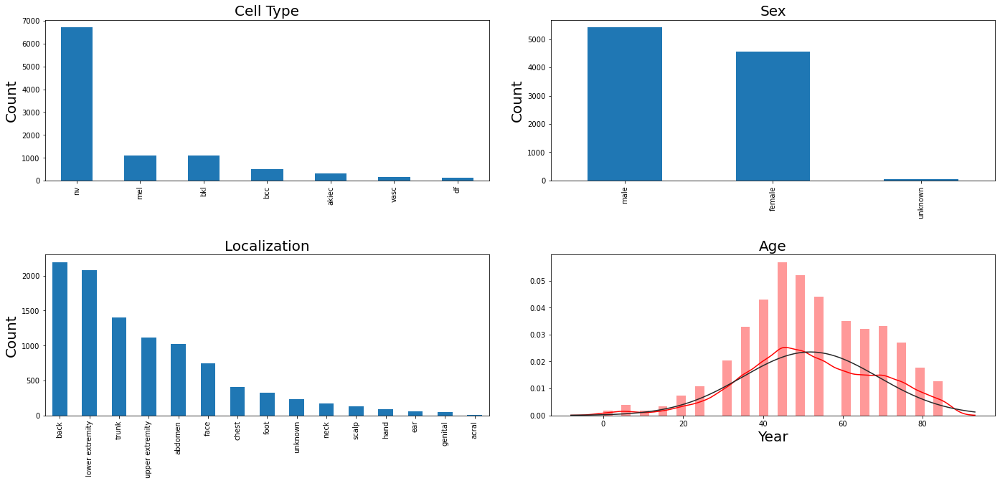

In [3]:
#fig = plt.figure()
rows, cols = 2, 2
fig, ax = plt.subplots(rows, cols, figsize=(20, 10))

metadata['dx'].value_counts().plot(kind='bar', ax=ax[0, 0])
metadata['sex'].value_counts().plot(kind='bar', ax=ax[0,1])
metadata['localization'].value_counts().plot(kind='bar', ax=ax[1,0])
sns.distplot(metadata['age'], fit=stats.norm, color='red');

ax[0,0].set_title('Cell Type', size=20)

ax[0,1].set_title('Sex', size=20);

ax[1,0].set_title('Localization', size=20)

ax[1,1].set_title('Age', size=20)
ax[1,1].set_xlabel('Year', size=20)


for row in range(rows):
    for col in range(cols):
        ax[row, col].set_ylabel('Count', size=20)
        ax[row, col].tick_params(labelsize=10)
        ax[row, col].tick_params(labelsize=10)
ax[1,1].set_ylabel('')
plt.tight_layout(pad=3.0)
plt.show()

There is an imbalance in the data. Certain cancer types have a much bigger 'count'. For this reason we will need to calculate the weights

In [4]:
# this will make all the necessary sample folders of 5 images for each type

#import os
#import shutil

#print(os.getcwd())

#dataDir = os.getcwd() + '/data/'
#dataDir =  "/data"
destDir = dataDir

#os.mkdir(destDir)
#print(dataDir)
#print(destDir)
#os.mkdir(destDir)

label = ['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec']
label_images = []


for i in label:
    os.mkdir(destDir + str(i) + '/')
    sample = metadata[metadata['dx'] == i]['image_id'][:5]
    label_images.extend(sample)
    for id in label_images:
        #shutil.copyfile((dataDir + 'HAM10000_images_part_1/' + i + "/"+ id +".jpg"), (destDir + i + "/"+id+".jpg"))
        #shutil.copyfile((dataDir + 'HAM10000_images_part_2/' + i + "/"+ id +".jpg"), (destDir + i + "/"+id+".jpg"))
        try:
            shutil.copyfile((dataDir + 'HAM10000_images_part_1/' + id +".jpg"), (destDir + i + "/"+id+".jpg"))
        except:
            shutil.copyfile((dataDir + 'HAM10000_images_part_2/' + id +".jpg"), (destDir + i + "/"+id+".jpg"))
        
    label_images=[]

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'C:\\Users\\mzogin\\Documents\\SpecialTopics\\lesion_classification/data/bkl/'

Now visualize the samples

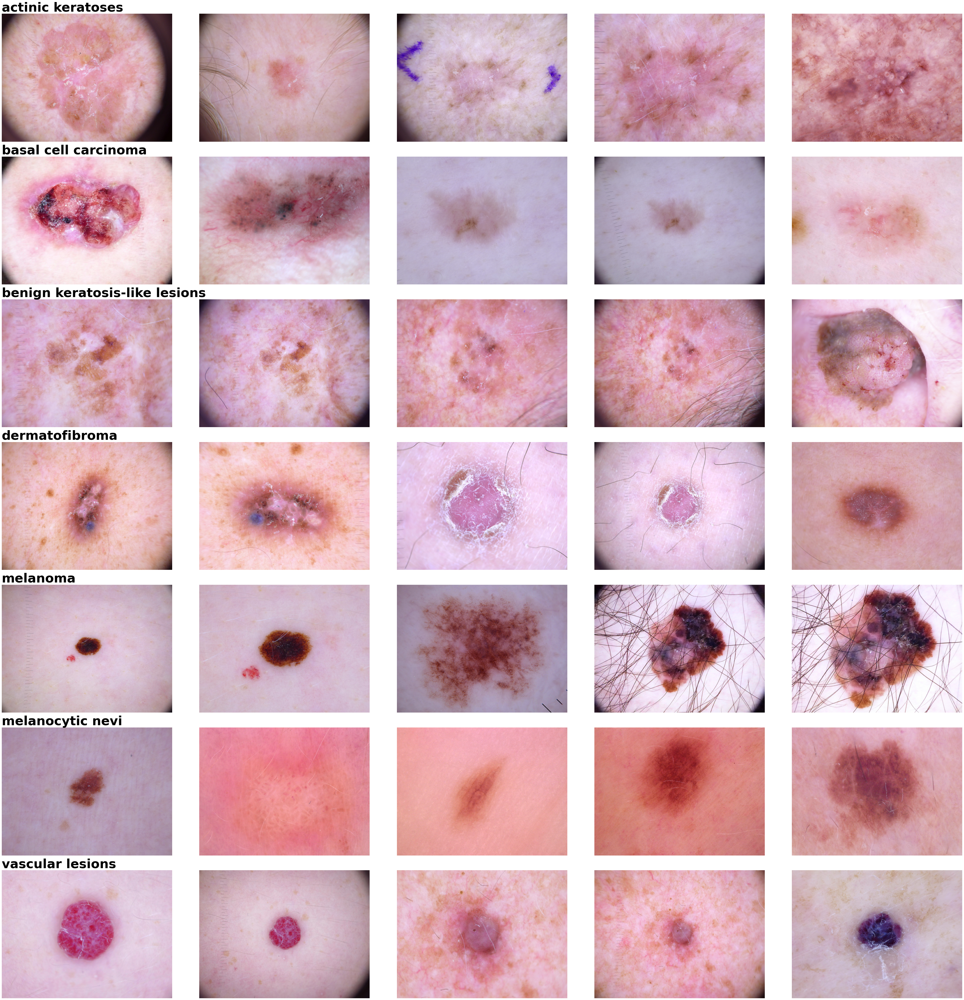

In [5]:
label = [ 'akiec', 'bcc','bkl','df','mel', 'nv',  'vasc']
label_images = []
classes = [ 'actinic keratoses', 'basal cell carcinoma', 'benign keratosis-like lesions', 
           'dermatofibroma','melanoma', 'melanocytic nevi', 'vascular lesions']

fig = plt.figure(figsize=(55, 55))
k = range(7)

for i in label:
    sample = metadata[metadata['dx'] == i]['image_id'][:5]
    label_images.extend(sample)
    
#for position,ID in enumerate(label_images):
    #print(position, ID)
    
    
for position,ID in enumerate(label_images):
    labl = metadata[metadata['image_id'] == ID]['dx']
    
    img = plt.imread(dataDir + label[int(position/5)] + '/' + ID + '.jpg')

    plt.subplot(7,5,position+1)
    plt.imshow(img)
    plt.axis('off')

    if position%5 == 0:
        title = int(position/5)
        plt.title(classes[title], loc='left', size=50, weight="bold")

plt.tight_layout()
plt.show()

Now calculate the weights to offset imbalance

In [6]:
label = [ 'akiec', 'bcc','bkl','df','mel', 'nv',  'vasc']
origLabel = label

weights = np.zeros_like(label, dtype=float) # initialize as zeros floats
counts = np.zeros_like(label) # also init as zeros
for i,j in enumerate(label):
    counts[i] = metadata[metadata['dx']==str(j)]['dx'].value_counts()[0]
counts = counts.astype(float)

median_freq = np.median(counts)

for i, label in enumerate(label):
    #print(label)
    weights[i] = median_freq / counts[i]

for i in range(len(origLabel)):
    print(origLabel[i],":", weights[i])

# put in dictionary for later step
weights = dict(zip(origLabel, weights))
weights
#type(weights)

akiec : 1.5718654434250765
bcc : 1.0
bkl : 0.467697907188353
df : 4.469565217391304
mel : 0.4618149146451033
nv : 0.07665920954511558
vasc : 3.619718309859155


{'akiec': 1.5718654434250765,
 'bcc': 1.0,
 'bkl': 0.467697907188353,
 'df': 4.469565217391304,
 'mel': 0.4618149146451033,
 'nv': 0.07665920954511558,
 'vasc': 3.619718309859155}

Copy images to their new folder for use with ImageFolder

In [7]:
# first merge the two image folders into one folder

# current folder path
current_folder = os.getcwd() + "/data/"
  
# list of folders to be merged
list_dir = ['HAM10000_images_part_1', 'HAM10000_images_part_2']
  
# enumerate on list_dir to get the 
# content of all the folders and store it in a dictionary
content_list = {}
for index, val in enumerate(list_dir):
    path = os.path.join(current_folder, val)
    content_list[ list_dir[index] ] = os.listdir(path)
 
merge_folder_path = current_folder + 'images/'
os.mkdir(merge_folder_path)
 # loop through the list of folders
for sub_dir in content_list:
  
    # loop through the contents of the
    # list of folders
    for contents in content_list[sub_dir]:
  
        # make the path of the content to move 
        path_to_content = sub_dir + "/" + contents  
  
        # make the path with the current folder
        dir_to_move = os.path.join(current_folder, path_to_content )
  
        # move the file
        shutil.move(dir_to_move, merge_folder_path)

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'C:\\Users\\mzogin\\Documents\\SpecialTopics\\lesion_classification/data/images/'

In [8]:
import glob2
# now we can just go through the new image folder

data_dir = os.getcwd() + "/data/"
dest_dir = os.getcwd() + "/sorted_data/"
#dest_dir = data_dir + "test/"
metadata = pd.read_csv(data_dir + 'HAM10000_metadata')

label = ['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec']
label_images = []
os.mkdir(dest_dir)

for i in label:
    os.mkdir(dest_dir + str(i) + "/")
    sample = metadata[metadata['dx'] == i]['image_id'] #modified here to exclude [:5]
    label_images.extend(sample)
    for id in label_images:
        #shutil.copyfile((data_dir + i + "/"+ id +".jpg"), (dest_dir + i + "/"+id+".jpg"))
        shutil.copyfile((data_dir + "images/" + id +".jpg"), (dest_dir + i + "/"+id+".jpg"))
        #try:
            #shutil.copyfile((data_dir + 'HAM10000_images_part_1/' + id +".jpg"), (dest_dir + i + "/"+id+".jpg"))
        #except:
            #shutil.copyfile((data_dir + 'HAM10000_images_part_2/' + id +".jpg"), (dest_dir + i + "/"+id+".jpg"))
    label_images=[]

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'C:\\Users\\mzogin\\Documents\\SpecialTopics\\lesion_classification/sorted_data/'

In [9]:
# get current size of images
im = imageio.imread("sorted_data/bkl/ISIC_0024312.jpg")
im.shape

(450, 600, 3)

In [10]:
# Read in the data using ImageFolder(for loading your own image dataset)

from torchvision import datasets, transforms

#LeNet needs size 32x32 to work
transform = transforms.Compose([
    transforms.Resize((32, 32)),
    transforms.ToTensor()
])

dataset = datasets.ImageFolder("sorted_data", transform=transform) # sorted_data is our root
print(dataset)

Dataset ImageFolder
    Number of datapoints: 10015
    Root location: sorted_data
    StandardTransform
Transform: Compose(
               Resize(size=(32, 32), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
           )


Read in data into imagefolder
Source for inspiration
https://www.kaggle.com/code/leifuer/intro-to-pytorch-loading-image-data/notebook

In [11]:
# 80/10/10 is a good split to start with
print(len(dataset))
print(len(dataset) * 0.8)
print(len(dataset) * 0.1)
print(len(dataset) * 0.1)

10015
8012.0
1001.5
1001.5


split the datasets into test and train data
Use test_train_split for this (also may involve DataLoader/Subset) 

In [12]:
from sklearn.model_selection import train_test_split

train_indices, val_indices = train_test_split(list(range(len(dataset.targets))), test_size=0.1, stratify=dataset.targets)
train_dataset = torch.utils.data.Subset(dataset, train_indices)
val_dataset = torch.utils.data.Subset(dataset, val_indices)

train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4, drop_last=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=32, shuffle=True, num_workers=4, drop_last=True) 

"""
OLD CODE
from sklearn.model_selection import train_test_split
# metadata = pd.read_csv(dataDir + 'HAM10000_metadata')
data = metadata.values
#split into input and outputs
X, y = data[:, :-1], data[:, -1]
print(X.shape, y.shape)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
"""

"\nOLD CODE\nfrom sklearn.model_selection import train_test_split\n# metadata = pd.read_csv(dataDir + 'HAM10000_metadata')\ndata = metadata.values\n#split into input and outputs\nX, y = data[:, :-1], data[:, -1]\nprint(X.shape, y.shape)\nX_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)\nprint(X_train.shape, X_test.shape, y_train.shape, y_test.shape)\n"

LeNet

https://pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html

In [13]:
# https://medium.com/@shaleenag/lenet-5-cnn-architecture-468ed7b895cd
# https://pyimagesearch.com/2021/07/19/pytorch-training-your-first-convolutional-neural-network-cnn/
import torch.nn as nn
import torch.nn.functional as F

class Net(nn.Module):
    def __init__(self, num_channels, num_classes):
        super().__init__()
        # convolution and max pooling layers
        # Layer C1: Convolution Layer (num_kernels=4, kernel_size=5×5 --> (5), padding=0, stride=1)
        # https://towardsdatascience.com/conv2d-to-finally-understand-what-happens-in-the-forward-pass-1bbaafb0b148
        self.conv1 = nn.Conv2d(num_channels, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        
        # the 3 linear layers
        # https://pythonguides.com/pytorch-nn-linear/
        self.fc1 = nn.Linear(16 * 5 * 5, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, num_classes)

    # receive image x as input and sequentially pass it through network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        
        return x
    

# num_channels should be 3 for RGB images and numclasses is all our cell types
net = Net(num_channels=3, num_classes=len(origLabel)) # labels
net

Net(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (fc1): Linear(in_features=400, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=7, bias=True)
)

In [14]:
weights
type(weights)

dict

In [15]:
typeWeights = list(weights.values())

import torch.optim as optim

opt = optim.Adam(net.parameters(), lr=1e-3)

typeWeights = torch.tensor(typeWeights, dtype=torch.float)
loss_fn = nn.CrossEntropyLoss(weight=typeWeights)   # weights previously calculated

In [16]:
dataloaders = { "train": train_dataloader, "val": val_dataloader }

dataset_sizes = {"train": len(train_indices), "val": len(val_indices)}

In [17]:
from torchvision import datasets, models, transforms
from torch.optim import lr_scheduler
import copy

lenet_train_loss = []
lenet_val_loss = []

lenet_train_acc = []
lenet_val_acc = []

epochs = 10

for epoch in range(epochs):

    total = 0
    correct = 0
    best_model_wts = copy.deepcopy(net.state_dict())
    best_acc = 0.0
    
    print("Epoch:", epoch)
    
    for phase in ['train', 'val']:
        if phase == 'train':
            net.train()  # set model to train
        else:
            net.eval()   # set model to evaluate
            
        running_loss = 0.0
        running_corrects = 0
            
        for inputs, labels in dataloaders[phase]:
            # clear parameter gradients
            opt.zero_grad()

            with torch.set_grad_enabled(phase == 'train'):
                # forward pass & calculate training loss
                outputs = net(inputs)
                _, preds = torch.max(outputs, 1)
                loss = loss_fn(outputs, labels)

                # backward & optimize only in training phase
                if phase == 'train':
                    loss.backward()   # backward pass
                    opt.step()  # update the weights
                    
            # statistics
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

        epoch_loss = running_loss / dataset_sizes[phase]
        epoch_acc = running_corrects.double() / dataset_sizes[phase]
            
        # track the change in accuracy & loss
        if phase == "train":
            lenet_train_loss.append(epoch_loss)
            lenet_train_acc.append(epoch_acc)

        else:
            lenet_val_loss.append(epoch_loss)
            lenet_val_acc.append(epoch_acc)

        print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase.capitalize(), epoch_loss, epoch_acc))
        
        if phase == 'val' and epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(net.state_dict())

    print()
    
print('Best Val Acc: {:4f}'.format(best_acc))
print("\nFinished running model")

Epoch: 0
Train Loss: 1.8216 Acc: 0.4288
Val Loss: 1.7164 Acc: 0.4361

Epoch: 1
Train Loss: 1.7354 Acc: 0.4597
Val Loss: 1.8126 Acc: 0.5589

Epoch: 2
Train Loss: 1.7088 Acc: 0.4517
Val Loss: 1.6352 Acc: 0.5040

Epoch: 3
Train Loss: 1.6654 Acc: 0.4679
Val Loss: 1.6035 Acc: 0.5200

Epoch: 4
Train Loss: 1.6036 Acc: 0.4703
Val Loss: 1.5890 Acc: 0.4481

Epoch: 5
Train Loss: 1.5197 Acc: 0.4343
Val Loss: 1.4260 Acc: 0.4760

Epoch: 6
Train Loss: 1.4147 Acc: 0.4859
Val Loss: 1.4714 Acc: 0.4371

Epoch: 7
Train Loss: 1.3742 Acc: 0.4910
Val Loss: 1.3882 Acc: 0.5778

Epoch: 8
Train Loss: 1.3178 Acc: 0.5173
Val Loss: 1.3606 Acc: 0.5758

Epoch: 9
Train Loss: 1.3136 Acc: 0.5316
Val Loss: 1.3628 Acc: 0.5649

Best Val Acc: 0.564870

Finished running model


Plot our model learning curves (start with optimization)

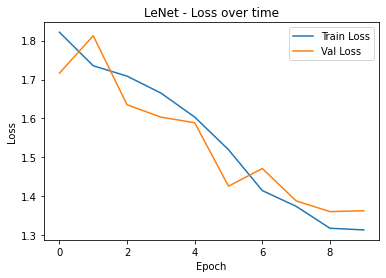

In [18]:
# Learning curves - https://machinelearningmastery.com/learning-curves-for-diagnosing-machine-learning-model-performance/
# Learning performance over time
# Matplotlib w/ Legend - https://stackoverflow.com/questions/19125722/adding-a-legend-to-pyplot-in-matplotlib-in-the-simplest-manner-possible

x_axis = [i for i in range(len(lenet_train_loss))]

plt.plot(x_axis, lenet_train_loss, label="Train Loss")
plt.plot(x_axis, lenet_val_loss, label="Val Loss")

plt.title("LeNet - Loss over time")
plt.xlabel("Epoch") # our time
plt.ylabel("Loss")
plt.legend()

Now the accuracy learning curve

https://machinelearningmastery.com/learning-curves-for-diagnosing-machine-learning-model-performance/

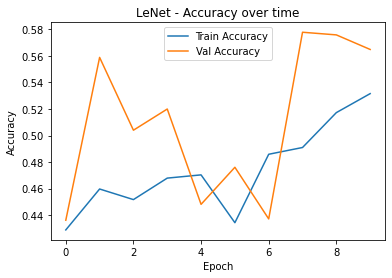

In [19]:
x_axis = [i for i in range(len(lenet_train_acc))]

plt.plot(x_axis, lenet_train_acc, label="Train Accuracy")
plt.plot(x_axis, lenet_val_acc, label="Val Accuracy")

plt.title("LeNet - Accuracy over time")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()

ResNet

https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html

In [20]:
from torchvision import datasets, models, transforms
from torch.optim import lr_scheduler
import copy

train_loss = []
val_loss = []

train_acc = []
val_acc = []

def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    # https://forums.fast.ai/t/understanding-code-error-expected-more-than-1-value-per-channel-when-training/9257/10 
    # Doing model.eval() before the run solves the problem as you are turning off the batchnorm
    # model.eval()
    
    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # set model to train
            else:
                model.eval()   # set model to evaluate

            running_loss = 0.0
            running_corrects = 0

            # iterate over data
            for inputs, labels in dataloaders[phase]:
                # For GPU/Cuda
                # inputs = inputs.to(device)
                # labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            
            # track the change in accuracy & loss
            if phase == "train":
                train_loss.append(epoch_loss)
                train_acc.append(epoch_acc)
                
            else:
                val_loss.append(epoch_loss)
                val_acc.append(epoch_acc)
            
            
            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase.capitalize(), epoch_loss, epoch_acc))


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    print('Best Val Acc: {:4f}'.format(best_acc))
    print("\nFinished running model")

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

Load pretrained model & reset final fully connected layer

https://discuss.pytorch.org/t/indexerror-target-2-is-out-of-bounds/69614/7

In [21]:
model_ft = models.resnet18(pretrained=True)
num_ftrs = model_ft.fc.in_features

# num of classes should be out_features, bias True by default

model_ft.fc = nn.Linear(num_ftrs, len(origLabel)) # cell_types

criterion = nn.CrossEntropyLoss(weight=typeWeights) #class_weights
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

# train and evaluate for 10 epochs

model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler, num_epochs=10)

Epoch 0/9
----------
Train Loss: 1.5664 Acc: 0.4768
Val Loss: 1.2712 Acc: 0.5709

Epoch 1/9
----------
Train Loss: 1.2025 Acc: 0.5673
Val Loss: 1.1115 Acc: 0.5788

Epoch 2/9
----------
Train Loss: 1.1167 Acc: 0.5825
Val Loss: 1.1805 Acc: 0.3683

Epoch 3/9
----------
Train Loss: 1.0243 Acc: 0.6071
Val Loss: 1.1633 Acc: 0.6018

Epoch 4/9
----------
Train Loss: 0.9767 Acc: 0.6210
Val Loss: 1.0851 Acc: 0.6257

Epoch 5/9
----------
Train Loss: 0.8580 Acc: 0.6432
Val Loss: 0.9749 Acc: 0.6557

Epoch 6/9
----------
Train Loss: 0.7699 Acc: 0.6660
Val Loss: 1.1549 Acc: 0.7136

Epoch 7/9
----------
Train Loss: 0.6040 Acc: 0.7029
Val Loss: 0.9922 Acc: 0.6756

Epoch 8/9
----------
Train Loss: 0.5217 Acc: 0.7256
Val Loss: 1.0399 Acc: 0.6986

Epoch 9/9
----------
Train Loss: 0.4973 Acc: 0.7388
Val Loss: 1.0368 Acc: 0.6956

Best Val Acc: 0.713573

Finished running model


Learning curves part 2, starting with optimization

https://machinelearningmastery.com/learning-curves-for-diagnosing-machine-learning-model-performance/

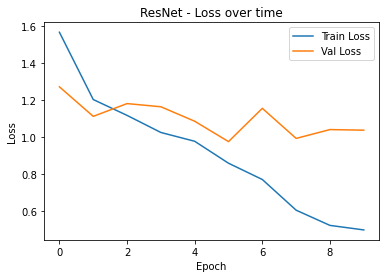

In [22]:
x_axis = [i for i in range(len(train_loss))]

plt.plot(x_axis, train_loss, label="Train Loss")
plt.plot(x_axis, val_loss, label="Val Loss")

plt.title("ResNet - Loss over time")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

Now the accuracy

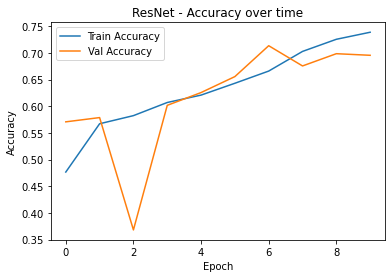

In [23]:
x_axis = [i for i in range(len(train_acc))]

plt.plot(x_axis, train_acc, label="Train Accuracy")
plt.plot(x_axis, val_acc, label="Val Accuracy")

plt.title("ResNet - Accuracy over time")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()